<a href="https://colab.research.google.com/github/cawcawlabs/ouster_lidar_appnotes/blob/main/ouster_sdk_open3d.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!wget https://data.ouster.io/sdk-samples/Rev-05/OS1-128_Rev-05_Urban-Drive/OS1-128_Rev-05_Urban-Drive.zip

!unzip /content/OS1-128_Rev-05_Urban-Drive.zip

In [ ]:
!pip install 'ouster-sdk'

In [ ]:
!pip install open3d

In [ ]:
import numpy as np
import open3d as o3d
import plotly.graph_objects as go

In [ ]:
pcap_path = '/content/OS1-128_Rev-05_Urban-Drive.pcap'
metadata_path = '/content/OS1-128_Rev-05_Urban-Drive.json'

In [ ]:
from ouster import client
with open(metadata_path, 'r') as f:
    info = client.SensorInfo(f.read())

In [ ]:
from ouster import pcap
source = pcap.Pcap(pcap_path, info)

In [ ]:
from contextlib import closing
from more_itertools import nth
with closing(client.Scans(source)) as scans:
    scan = nth(scans, 50)

In [ ]:
range_field = scan.field(client.ChanField.RANGE)
range_img = client.destagger(info, range_field)

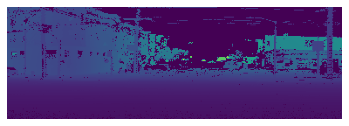

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(range_img[:, 640:1024], resample=False)
plt.axis('off')
plt.show()

In [ ]:
def draw(geometries):
    graph_obj = []

    for gm in geometries:
        geometry_type = gm.get_geometry_type()
        
        if geometry_type == o3d.geometry.Geometry.Type.PointCloud:
            pts = np.asarray(gm.points)
            clr = None  #for colors
            if gm.has_colors():
                clr = np.asarray(gm.colors)
            elif gm.has_normals():
                clr = (0.5, 0.5, 0.5) + np.asarray(gm.normals) * 0.5
            else:
                gm.paint_uniform_color((1.0, 0.0, 0.0))
                clr = np.asarray(gm.colors)

            sc = go.Scatter3d(x=pts[:,0], y=pts[:,1], z=pts[:,2], mode='markers', marker=dict(size=1, color=clr))
            graph_obj.append(sc)
        
    fig = go.Figure(
        data=graph_obj,
        layout=dict(
            scene=dict(
                xaxis=dict(visible=False),
                yaxis=dict(visible=False),
                zaxis=dict(visible=False),
                #dsohn
                aspectmode='data'
            )
        )
    )
    fig.update_layout(paper_bgcolor="black")
    fig.show()

In [ ]:
def colorize(image: np.ndarray):
    """Use Ouster spezia colormap to get from gray to color space.
    Args:
        image: 2D array of values in the range [0, 1]
    Returns:
        Array of RGB values of the same dimension selected from the color map
    """
    key_img_indices = (255 * image).astype(np.uint8)
    return np.reshape(np.take(spezia, key_img_indices.flat, axis=0),
                      [image.shape[0], image.shape[1], 3])

spezia = np.array(
    # [0.04890922165917825, 0.34265700288230266, 0.5139042200196196],
    [[0.0, 0.0, 0.0],
     [0.04895672077739804, 0.34399228711079705, 0.5173325088859984],
     [0.04899969158023907, 0.34532432182766976, 0.5207851330769154],
     [0.049038068929181285, 0.34665300013643424, 0.5242624999557384],
     [0.0490717860366443, 0.3479782119131098, 0.5277650273921529],
     [0.04910077440233592, 0.34929984367863964, 0.5312931441090918],
     [0.04912496374647964, 0.35061777846523556, 0.5348472900437968],
     [0.049144281939685876, 0.35193189567631167, 0.5384279167237124],
     [0.04915865492929047, 0.3532420709396423, 0.5420354876579142],
     [0.04916800666192803, 0.3545481759533582, 0.5456704787448663],
     [0.04917225900211732, 0.3558500783243678, 0.5493333786972924],
     [0.04917133164659893, 0.35714764139876426, 0.553024689485032],
     [0.0491651420341628, 0.35844072408375016, 0.5567449267967906],
     [0.049153605250673076, 0.35972918066057785, 0.5604946205217287],
     [0.04913663392897654, 0.36101286058797066, 0.5642743152519267],
     [0.04911413814335756, 0.36229160829545354, 0.5680845708067875],
     [0.04908602529819959, 0.36356526296598163, 0.5719259627805287],
     [0.04905220001042406, 0.36483365830721187, 0.5757990831139734],
     [0.04901256398533129, 0.36609662231071893, 0.5797045406919258],
     [0.04896701588534969, 0.36735397699840217, 0.5836429619674972],
     [0.04891545119124254, 0.36860553815528246, 0.5876149916148347],
     [0.04885776205520153, 0.36985111504782353, 0.5916212932117864],
     [0.048793837145294165, 0.371090510126853, 0.5956625499541581],
     [0.048723561480604215, 0.37232351871408936, 0.5997394654032839],
     [0.04864681625641982, 0.37354992867120285, 0.6038527642687842],
     [0.0485634786587359, 0.37476952005026626, 0.6080031932284756],
     [0.04847342166723854, 0.3759820647243526, 0.6121915217875443],
     [0.04837651384597603, 0.37718732599695254, 0.6164185431792271],
     [0.04827261912068898, 0.3783850581887729, 0.6206850753093874],
     [0.04816159654185025, 0.37957500620037093, 0.6249919617475522],
     [0.04804330003224206, 0.38075690504895116, 0.6293400727671268],
     [0.047917578117875524, 0.3819304793775204, 0.633730306437712],
     [0.04778427364089425, 0.38309544293445374, 0.6381635897726399],
     [0.04764322345301101, 0.38425149802135766, 0.6426408799350484],
     [0.04749425808786458, 0.385398334906948, 0.6471631655060938],
     [0.04733720141054259, 0.3865356312044689, 0.6517314678190856],
     [0.04717187024231324, 0.3876630512099673, 0.6563468423636755],
     [0.046998073958454976, 0.38878024519851034, 0.6610103802644818],
     [0.046815614056824016, 0.3898868486751851, 0.6657232098388559],
     [0.04662428369457814, 0.3909824815774357, 0.6704864982388766],
     [0.04642386719018477, 0.39206674742499825, 0.6753014531830023],
     [0.04621413948754389, 0.39313923241335524, 0.6801693247832367],
     [0.045994865578738504, 0.3941995044462622, 0.6850914074741193],
     [0.04576579988147745, 0.39524711210249736, 0.6900690420503143],
     [0.04552668556693947, 0.3962815835315315, 0.6951036178201221],
     [0.04527725383318241, 0.39730242527232407, 0.7001965748827989],
     [0.04501722311872807, 0.39830912098889804, 0.7053494065382041],
     [0.04474629825033485, 0.39930113011574186, 0.7105636618379779],
     [0.044464169518219306, 0.4002778864054065, 0.7158409482881979],
     [0.044170511671191286, 0.4012387963699213, 0.7211829347142875],
     [0.04386498282321687, 0.4021832376068135, 0.7265913542998228],
     [0.04354722326188234, 0.4031105569995846, 0.7320680078119023],
     [0.04321685414797862, 0.40402006878146585, 0.7376147670267773],
     [0.0428734760940282, 0.40491105245010933, 0.743233578370643],
     [0.042516667607970175, 0.40578275051957646, 0.748926466791789],
     [0.04214598338630927, 0.4066343660945334, 0.7546955398817109],
     [0.04176095243886018, 0.40746506024993384, 0.7605429922643745],
     [0.04136107602475044, 0.40827394919762916, 0.766471110274553],
     [0.04094582537627162, 0.4090601012192915, 0.7724822769480404],
     [0.04051463918382638, 0.40982253334270374, 0.7785789773486957],
     [0.040061502782456945, 0.4105602077358398, 0.7847638042595603],
     [0.03959294089889664, 0.41127202779018696, 0.7910394642679004],
     [0.039109793546916495, 0.4119568338613871, 0.7974087842769024],
     [0.03861172210191932, 0.41261339863144436, 0.803874718479878],
     [0.0380983735795864, 0.4132404220523802, 0.8104403558364525],
     [0.03756937968562651, 0.4138365258262561, 0.8171089280940507],
     [0.03702435578736771, 0.4144002473707861, 0.8238838184024792],
     [0.0364628997996382, 0.4149300332132621, 0.8307685705742502],
     [0.03588459097638143, 0.4154242317480496, 0.8377668990487521],
     [0.035288988598694025, 0.4158810852842974, 0.844882699624589],
     [0.03467563054866628, 0.4162987213006144, 0.8521200610312002],
     [0.03404403175731731, 0.41667514281199364, 0.8594832774186676],
     [0.033393682513460185, 0.41700821774098445, 0.8669768618532854],
     [0.03272404661867004, 0.41729566716967786, 0.8746055609162682],
     [0.032034559371859575, 0.4175350523310705, 0.8823743705140761],
     [0.03132462536474723, 0.41772376017735885, 0.8902885530212784],
     [0.03059361606719027, 0.417858987338036, 0.8983536558911435],
     [0.029840867178669222, 0.41793772225168413, 0.9065755318852089],
     [0.02906567571902483, 0.4179567252211435, 0.9149603610913213],
     [0.028267296828018075, 0.41791250610119823, 0.9235146749206897],
     [0.027444940239127507, 0.41780129927982523, 0.9322453822980893],
     [0.026597766388240202, 0.4176190355565933, 0.9411597982868389],
     [0.02572488211232861, 0.41736131045306674, 0.9502656754213602],
     [0.02482533588680886, 0.41702334840740857, 0.9595712380560552],
     [0.023898112542860842, 0.416599962205498, 0.9690852200808441],
     [0.02294212739712791, 0.41608550687982504, 0.9788169064013666],
     [0.02195621971619119, 0.4154738271597193, 0.9887761786374855],
     [0.03533572637548167, 0.4150344767837667, 0.9966419438918287],
     [0.08206748636661013, 0.4154760610454022, 0.996875442497312],
     [0.1131664468320158, 0.4159292422424467, 0.9971067037505105],
     [0.1377759789309851, 0.4163940123475041, 0.9973357493609963],
     [0.1586260932452447, 0.4168703621191211, 0.9975626007042689],
     [0.17695881259992585, 0.41735828111703227, 0.997787278826484],
     [0.19346029551091778, 0.4178577577177723, 0.9980098044491156],
     [0.2085556849234767, 0.4183687791306285, 0.9982301979735458],
     [0.22252938052310162, 0.41889133141394447, 0.9984484794855942],
     [0.2355824089832244, 0.4194253994917421, 0.9986646687599702],
     [0.24786290560296725, 0.4199709671706614, 0.9988787852646682],
     [0.25948364869956886, 0.42052801715720073, 0.9990908481652964],
     [0.2705327829044692, 0.42109653107524325, 0.9993008763293371],
     [0.2810807045979947, 0.4216764894838623, 0.9995088883303488],
     [0.2911846624744039, 0.4222678718953844, 0.9997149024521047],
     [0.30089193496804306, 0.4228706567937021, 0.9999189366926701],
     [0.3199598560384707, 0.4211529467871777, 1.0000000000000044],
     [0.3436114893370144, 0.4178742172053897, 1.0000000000000047],
     [0.36539676089694495, 0.41458308629177515, 1.0000000000000044],
     [0.3856661632570949, 0.41127775518053283, 1.0000000000000042],
     [0.404675301565696, 0.407956362084171, 1.0000000000000044],
     [0.4226172861700883, 0.4046169767859018, 1.0000000000000047],
     [0.43964219386021874, 0.40125759469274436, 1.0000000000000047],
     [0.45586938841351193, 0.3978761303980185, 1.0000000000000047],
     [0.47139565849043324, 0.39447041069519134, 1.0000000000000047],
     [0.4863007849418988, 0.3910381669772773, 1.0000000000000047],
     [0.5006514638539757, 0.3875770269469873, 1.0000000000000044],
     [0.5145041416968924, 0.3840845055522841, 1.0000000000000047],
     [0.5279071095300848, 0.3805579950497078, 1.0000000000000047],
     [0.5409020797263486, 0.3769947540834305, 1.0000000000000044],
     [0.5535253932438766, 0.3733918956509583, 1.0000000000000044],
     [0.5658089579546876, 0.3697463738064324, 1.0000000000000042],
     [0.577780987780821, 0.366054968928604, 1.0000000000000049],
     [0.589466591997403, 0.3623142713523205, 1.0000000000000047],
     [0.6008882502481963, 0.35852066312849035, 1.0000000000000044],
     [0.6120661992793963, 0.3546702976368881, 1.0000000000000047],
     [0.6230187506929341, 0.35075907672718176, 1.0000000000000047],
     [0.6337625542333337, 0.34678262500419443, 1.0000000000000047],
     [0.6443128176539651, 0.3427362608011279, 1.0000000000000044],
     [0.6546834916623888, 0.33861496329592544, 1.0000000000000047],
     [0.664887426552217, 0.3344133351169368, 1.0000000000000044],
     [0.6749365057066918, 0.3301255596489445, 1.0000000000000047],
     [0.6848417600790246, 0.32574535208217403, 1.0000000000000047],
     [0.6946134669261637, 0.32126590303548275, 1.0000000000000049],
     [0.7042612354316643, 0.31667981331755896, 1.0000000000000047],
     [0.7137940813531695, 0.3119790180493533, 1.0000000000000049],
     [0.7232204924365964, 0.3071546979334297, 1.0000000000000049],
     [0.7325484860275505, 0.30219717488892517, 1.0000000000000047],
     [0.7417856600618409, 0.2970957885292609, 1.000000000000005],
     [0.7509392384175178, 0.2918387489798506, 1.0000000000000047],
     [0.760016111449703, 0.28641296022435003, 1.0000000000000047],
     [0.7690228723986646, 0.2808038063993306, 1.0000000000000049],
     [0.7779658502549104, 0.27499489103633235, 1.0000000000000049],
     [0.7868511395774846, 0.2689677158905533, 1.0000000000000047],
     [0.7956846276897148, 0.26270128126132847, 1.0000000000000047],
     [0.804472019617065, 0.2561715829275765, 1.0000000000000047],
     [0.8132188610824966, 0.2493509709254887, 1.0000000000000047],
     [0.8219305598337341, 0.24220732066040862, 1.0000000000000049],
     [0.8306124055427538, 0.23470294440057987, 1.0000000000000049],
     [0.8392695884894237, 0.2267931361345682, 1.0000000000000047],
     [0.847907217217596, 0.21842418639150069, 1.0000000000000047],
     [0.8565303353323375, 0.20953060994411976, 1.0000000000000049],
     [0.8651439375907393, 0.20003116767718654, 1.0000000000000049],
     [0.8737529854254381, 0.18982297245453064, 1.0000000000000049],
     [0.8823624220291222, 0.17877241522237444, 1.0000000000000047],
     [0.8909771871196978, 0.1667005280966983, 1.0000000000000047],
     [0.8996022314990386, 0.15335795616479617, 1.000000000000005],
     [0.9082425315133318, 0.13837882372526109, 1.0000000000000049],
     [0.9169031035195819, 0.12118667725012405, 1.0000000000000049],
     [0.9255890184609986, 0.10077304980525353, 1.0000000000000047],
     [0.9343054166534386, 0.07504334998300113, 1.0000000000000049],
     [0.9430575228859241, 0.03781952178921804, 1.000000000000005],
     [0.9509350420238839, 1.4218570765223148e-13, 0.9989984483716071],
     [0.9554497353124459, 1.4191675612451605e-13, 0.9943640499109371],
     [0.9599176427714787, 1.4433731987395504e-13, 0.9897799632511853],
     [0.9643412154073002, 1.4245465917994694e-13, 0.9852425190239346],
     [0.9687227616942858, 1.4191675612451605e-13, 0.9807481714229297],
     [0.9730644583865243, 1.411995520506082e-13, 0.9762934885028384],
     [0.9773683603724937, 1.3931689135660008e-13, 0.9718751430792824],
     [0.9816364096714153, 1.3886863881040766e-13, 0.9674899041721569],
     [0.9858704436584534, 1.4039269746746187e-13, 0.9631346289394122],
     [0.9900722025959202, 1.4397871783700112e-13, 0.9588062550529955],
     [0.9942433365389557, 1.4155815408756212e-13, 0.954501793472642],
     [0.9983854116765075, 1.3752388117183045e-13, 0.9502183215767478],
     [0.9999999999999819, 0.02804423714351181, 0.9437140548413381],
     [0.9999999999999823, 0.0675265531658979, 0.9359017685954015],
     [0.9999999999999826, 0.09447578037166751, 0.9282451825736049],
     [0.9999999999999823, 0.11567880450339993, 0.920737795368809],
     [0.9999999999999826, 0.13352190503381375, 0.9133734552831144],
     [0.9999999999999823, 0.1491028314594674, 0.906146335428585],
     [0.9999999999999826, 0.16303259275115084, 0.8990509109121838],
     [0.9999999999999826, 0.17569199214531872, 0.8920819378992011],
     [0.9999999999999826, 0.18733702217610845, 0.8852344343724449],
     [0.9999999999999826, 0.19814940356609517, 0.8785036624245576],
     [0.9999999999999823, 0.20826355122506324, 0.8718851119384158],
     [0.9999999999999823, 0.21778214249596284, 0.8653744855260821],
     [0.9999999999999826, 0.22678566871532468, 0.8589676846103573],
     [0.9999999999999823, 0.2353385863611125, 0.8526607965450058],
     [0.9999999999999828, 0.24349343831907827, 0.8464500826803465],
     [0.9999999999999826, 0.2512937077092952, 0.840331967290248],
     [0.9999999999999826, 0.2587758499993201, 0.8343030272849384],
     [0.999999999999983, 0.26739099502162367, 0.8275538904243963],
     [0.999999999999983, 0.2793555475103376, 0.8187524096848618],
     [0.9999999999999828, 0.29067538241472596, 0.810154074771914],
     [0.999999999999983, 0.3014349177286362, 0.8017491111724352],
     [0.9999999999999826, 0.31170258039783083, 0.7935283442712853],
     [0.9999999999999826, 0.3215347049761315, 0.7854831467895685],
     [0.9999999999999826, 0.3309782925632311, 0.7776053911816436],
     [0.9999999999999826, 0.3400730122474594, 0.7698874064041857],
     [0.9999999999999826, 0.34885268450644075, 0.7623219385454285],
     [0.999999999999983, 0.35734640143399626, 0.7549021148665397],
     [0.9999999999999826, 0.3655793867737775, 0.7476214108616114],
     [0.9999999999999826, 0.3735736659274856, 0.7404736199894286],
     [0.9999999999999828, 0.381348594792351, 0.7334528257702123],
     [0.9999999999999826, 0.38892128210540905, 0.7265533759748873],
     [0.9999999999999823, 0.3963069303390571, 0.7197698586639263],
     [0.9999999999999823, 0.4035191135203492, 0.7130970798581467],
     [0.9999999999999823, 0.410570005644612, 0.7065300426455539],
     [0.9999999999999821, 0.4174705699878856, 0.700063927546916],
     [0.9999999999999819, 0.4242307171780247, 0.6936940739785828],
     [0.9999999999999821, 0.4308594380852102, 0.6874159626644994],
     [0.9999999999999821, 0.4373649162525338, 0.6812251988606219],
     [0.9999999999999819, 0.44375462357781925, 0.6751174962642902],
     [0.9999999999999819, 0.4500354021895003, 0.6690886614886871],
     [0.9999999999999821, 0.45621353486890187, 0.6631345789884755],
     [0.9999999999999817, 0.4622948059133914, 0.657251196327135],
     [0.9999999999999817, 0.4682845539768576, 0.6514345096795133],
     [0.9999999999999817, 0.474187718141824, 0.645680549464667],
     [0.9999999999999817, 0.4800088782535285, 0.6399853660042518],
     [0.9999999999999815, 0.4857522903672667, 0.6343450151004509],
     [0.9999999999999815, 0.4914219180162633, 0.6287555434246979],
     [0.9999999999999815, 0.497021459890778, 0.6232129736041581],
     [0.9999999999999815, 0.5025543744242497, 0.6177132888869281],
     [0.9999999999999815, 0.5080239017046412, 0.6122524172590773],
     [0.999999999999981, 0.5134330830652836, 0.606826214876734],
     [0.9999999999999808, 0.518784778656747, 0.6014304486641499],
     [0.9999999999999808, 0.5240816832574693, 0.5960607779137368],
     [0.9999999999999806, 0.5293263405443853, 0.5907127347060119],
     [0.9999999999999806, 0.5345211560142691, 0.5853817029456958],
     [0.9999999999999808, 0.5396684087209026, 0.580062895784249],
     [0.9999999999999808, 0.5447702619716198, 0.5747513311680923],
     [0.9999999999999806, 0.5498287731085955, 0.5694418052146554],
     [0.9999999999999803, 0.5548459024848833, 0.5641288630740176],
     [0.9999999999999801, 0.5598235217321937, 0.5588067668806895],
     [0.9999999999999799, 0.5647634214064047, 0.5534694603362047],
     [0.9999999999999799, 0.569667318087479, 0.5481105293861371],
     [0.9999999999999801, 0.5745368610026079, 0.5427231583620321],
     [0.9999999999999797, 0.5793736382348097, 0.5373000808456486],
     [0.9999999999999797, 0.5841791825736894, 0.5318335243749407],
     [0.9999999999999797, 0.58895497706055, 0.5263151479421893],
     [0.9999999999999795, 0.5937024602763533, 0.5207359710263567],
     [0.9999999999999795, 0.5984230314181602, 0.5150862926436902],
     [0.9999999999999792, 0.6031180552074987, 0.5093555985787912],
     [0.9999999999999792, 0.607788866672662, 0.5035324545546109],
     [0.999999999999979, 0.6124367758461117, 0.4976043825895365],
     [0.999999999999979, 0.6170630724180334, 0.4915577171399405],
     [0.9999999999999788, 0.6216690303876014, 0.48537743679248463],
     [0.9999999999999788, 0.6262559127547657, 0.4790469661903673],
     [0.9999999999999784, 0.6308249762973255, 0.4725479414659382],
     [0.9999999999999786, 0.6353774764808859, 0.46585993058805514],
     [0.9999999999999784, 0.6399146725529954, 0.45896009754439654],
     [0.9999999999999784, 0.644437832877538, 0.45182279591800384],
     [0.9999999999999781, 0.6489482405714118, 0.4444190728188997],
     [0.9999999999999779, 0.6534471995128909, 0.4367160577509657],
     [0.9999999999999779, 0.6579360408000906, 0.4286762020035964],
     [0.9999999999999779, 0.6624161297489367, 0.42025632127341656],
     [0.9999999999999777, 0.6668888735333959, 0.41140637540952824],
     [0.9999999999999777, 0.6713557295869282, 0.40206789113388525],
     [0.9999999999999775, 0.6758182149038043, 0.3921718908087272]])

In [ ]:
# compute point cloud using client.SensorInfo and client.LidarScan

xyz = client.XYZLut(info)(scan)

# create point cloud and coordinate axes geometries

cloud = o3d.geometry.PointCloud(o3d.utility.Vector3dVector(xyz.reshape((-1, 3))))  # type: ignore
field_ind = 2
fields = list(scan.fields)
key = scan.field(fields[field_ind]).astype(float)
color_img = colorize(key)
cloud.colors = o3d.utility.Vector3dVector(color_img.reshape((-1, 3)))

axes = o3d.geometry.TriangleMesh.create_coordinate_frame(1.0)  # type: ignore


In [ ]:
o3d.visualization.draw_geometries = draw # replace function
o3d.visualization.draw_geometries([cloud,axes])